## AutoML

In this assignment, you will an AutoML library like H2O.ai to create predictive models and interpret them. Find a significant relation for each algorithm of your choosing in your data. Create multivariate models.

For the moment you will assume the data is good. In future assignments, you will check your data, fix data issues and do some feature engineering. 

Each student must find a dataset from Kaggle for binary classification, multiclass classification, regression that is unique. That is no two students can use the same data set.  A description of the data set and its fields must be given to a TA in markdown to be placed at  https://github.com/nikbearbrown/AI_Research_Group/tree/main/Kaggle_DatasetsLinks to an external site.  under the appropriate directory (binary classification, multiclass classification, regression).  If the dataset is greater than 50Mb a randomly sampled version just under 50Mb must be created and that is noted in the markdown description.

The dataset used MUST be approved by a TA.

Starter code for AutoML is in this folder   https://github.com/nikbearbrown/AI_Research_Group/tree/main/Kaggle_DatasetsLinks to an external site.

In particular, this notebook should get you started https://github.com/nikbearbrown/AI_Research_Group/blob/main/Kaggle_Datasets/AutoML/VAI_Churn_H2O_automl.ipynbLinks to an external site.

 

This assignment will focus on Node 4 of the simple analysis sequence.

AutoML_Assingment_Analysis_Pipeline.png

Answer the following questions for all of the models:

* Is the relationship significant?

* Are any model assumptions violated?

* Is there any multicollinearity in the model?

* In the multivariate models are predictor variables independent of all the other predictor variables?

* In in multivariate models rank the most significant predictor variables and exclude insignificant ones from the model.

* Does the model make sense?

* Does regularization help?

* Which independent variables are significant?

* Which hyperparameters are important?

 

Scoring Rubric

 

Did I explain my idea clearly? (10 Points)

How effective are you at explaining what you are doing? You MUST write an abstract and a conclusion.

Did I give my data to the TA to add to https://github.com/nikbearbrown/AI_Research_Group/tree/main/Kaggle_DatasetsLinks to an external site. ? (10 Points)

A description of the data set and its fields must be given to a TA in markdown to be placed at https://github.com/nikbearbrown/AI_Research_Group/tree/main/Kaggle_DatasetsLinks to an external site.  under the appropriate directory (binary classification, multiclass classification, regression).  If the dataset is greater than 50Mb a randomly sampled version just under 50Mb must be created and that is noted in the markdown description.

You MUST get approval for your dataset from the TAs.

 

Did I explain my evaluation clearly? (15 Points)

Just saying "accuracy" is not a clear explanation of an evaluation scheme. Clearly explain the evaluation scheme. Do the metrics make sense? You MUST explain how you are preventing overfitting.

 

Tables, graphs, and charts must support your evaluation.

It MUST run in Google Collab. You will also save the Google Collab notebook as a .ipynb notebook and upload that to Canvas . (5 Points)

 

What code is yours and what have you adapted? (10 Points)

You must explain what code you wrote and what you have done that is different. Failure to cite ANY code will result in a zero for this section.

 

Did I explain my code clearly? (15 Points) Your code review score will be scaled to a range of 0 to 10 and be used for this score.

 

Did I explain my licensing clearly? (5 Points) Failure to cite a clear license will result in a zero for this section.

 

Answers to listed questions (30 Points)

 

Answer the following questions for all of the models:

* Is the relationship significant?

* Are any model assumptions violated?

* Is there any multicollinearity in the model?

* In the multivariate models are predictor variables independent of all the other predictor variables?

* In in multivariate models rank the most significant predictor variables and exclude insignificant ones from the model.

* Does the model make sense?

* Does regularization help?

* Which independent variables are significant?

* Which hyperparameters are important?

* Coding professionalism?

## Abstract 
Rice, which is among the most widely produced grain products worldwide, has many genetic varieties. These varieties are separated from each other due to some of their features. Idea was to create dataset that is good for binary classification and that gives adequate results. Therefore, this notebook is created to perform EDA analysis and create multivariate models between rice quality and other features. This notebook use Logistic Regression Algorithm, Decision Tree Algorithm, Random Forest Algorithm to answer the following questions:

* Is the relationship significant?

* Are any model assumptions violated?

* Is there any multicollinearity in the model?

* In the multivariate models are predictor variables independent of all the other predictor variables?

* In in multivariate models rank the most significant predictor variables and exclude insignificant ones from the model.

* Does the model make sense?

* Does regularization help?

* Which independent variables are significant?

* Which hyperparameters are important?

* Coding professionalism?



In [1]:
!pip install eli5

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.offline as pyo
import plotly.express as px

import seaborn as sns
import missingno as msno

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.figure_factory as ff

from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV

from sklearn import metrics
from sklearn.metrics import roc_curve,auc
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

from mlxtend.plotting import plot_confusion_matrix

%matplotlib inline
pyo.init_notebook_mode()

## 1. Performing simple operations on dataframe 

In [3]:
## Read data
df = pd.read_csv('../input/rice-type-classification/riceClassification.csv')
df

,id,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
0,1,4537,92.229316,64.012769,0.719916,4677,76.004525,0.657536,273.085,0.764510,1.440796,1
1,2,2872,74.691881,51.400454,0.725553,3015,60.471018,0.713009,208.317,0.831658,1.453137,1
2,3,3048,76.293164,52.043491,0.731211,3132,62.296341,0.759153,210.012,0.868434,1.465950,1
3,4,3073,77.033628,51.928487,0.738639,3157,62.551300,0.783529,210.657,0.870203,1.483456,1
4,5,3693,85.124785,56.374021,0.749282,3802,68.571668,0.769375,230.332,0.874743,1.510000,1
...,...,...,...,...,...,...,...,...,...,...,...,...
18180,18181,5853,148.624571,51.029281,0.939210,6008,86.326537,0.498594,332.960,0.663444,2.912535,0
18181,18182,7585,169.593996,58.141659,0.939398,7806,98.272692,0.647461,385.506,0.641362,2.916910,0
18182,18183,6365,154.777085,52.908085,0.939760,6531,90.023162,0.561287,342.253,0.682832,2.925396,0
18183,18184,5960,151.397924,51.474600,0.940427,6189,87.112041,0.492399,343.371,0.635227,2.941216,0


In [4]:
## Show data head
df.head()

,id,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
0,1,4537,92.229316,64.012769,0.719916,4677,76.004525,0.657536,273.085,0.764510,1.440796,1
1,2,2872,74.691881,51.400454,0.725553,3015,60.471018,0.713009,208.317,0.831658,1.453137,1
2,3,3048,76.293164,52.043491,0.731211,3132,62.296341,0.759153,210.012,0.868434,1.465950,1
3,4,3073,77.033628,51.928487,0.738639,3157,62.551300,0.783529,210.657,0.870203,1.483456,1
4,5,3693,85.124785,56.374021,0.749282,3802,68.571668,0.769375,230.332,0.874743,1.510000,1


In [5]:
## Show data tail
df.tail()

,id,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
18180,18181,5853,148.624571,51.029281,0.939210,6008,86.326537,0.498594,332.960,0.663444,2.912535,0
18181,18182,7585,169.593996,58.141659,0.939398,7806,98.272692,0.647461,385.506,0.641362,2.916910,0
18182,18183,6365,154.777085,52.908085,0.939760,6531,90.023162,0.561287,342.253,0.682832,2.925396,0
18183,18184,5960,151.397924,51.474600,0.940427,6189,87.112041,0.492399,343.371,0.635227,2.941216,0
18184,18185,6134,153.081981,51.590606,0.941500,6283,88.374495,0.489975,338.613,0.672274,2.967245,0


In [6]:
df.columns

Index(['id', 'Area', 'MajorAxisLength', 'MinorAxisLength', 'Eccentricity',
       'ConvexArea', 'EquivDiameter', 'Extent', 'Perimeter', 'Roundness',
       'AspectRation', 'Class'],
      dtype='object')

In [7]:
## Print data shape
print('Total number of rows are:', df.shape[0])
print('Total number of columns are:', df.shape[1])

Total number of rows are: 18185
Total number of columns are: 12


In [8]:
df.describe()

,id,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
count,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000,18185.000000
mean,9093.000000,7036.492989,151.680754,59.807851,0.915406,7225.817872,94.132952,0.616653,351.606949,0.707998,2.599081,0.549079
std,5249.701658,1467.197150,12.376402,10.061653,0.030575,1502.006571,9.906250,0.104389,29.500620,0.067310,0.434836,0.497599
min,1.000000,2522.000000,74.133114,34.409894,0.676647,2579.000000,56.666658,0.383239,197.015000,0.174590,1.358128,0.000000
25%,4547.000000,5962.000000,145.675910,51.393151,0.891617,6125.000000,87.126656,0.538530,333.990000,0.650962,2.208527,0.000000
50%,9093.000000,6660.000000,153.883750,55.724288,0.923259,6843.000000,92.085696,0.601194,353.088000,0.701941,2.602966,1.000000
75%,13639.000000,8423.000000,160.056214,70.156593,0.941372,8645.000000,103.559146,0.695664,373.003000,0.769280,2.964101,1.000000
max,18185.000000,10210.000000,183.211434,82.550762,0.966774,11008.000000,114.016559,0.886573,508.511000,0.904748,3.911845,1.000000


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18185 entries, 0 to 18184
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               18185 non-null  int64  
 1   Area             18185 non-null  int64  
 2   MajorAxisLength  18185 non-null  float64
 3   MinorAxisLength  18185 non-null  float64
 4   Eccentricity     18185 non-null  float64
 5   ConvexArea       18185 non-null  int64  
 6   EquivDiameter    18185 non-null  float64
 7   Extent           18185 non-null  float64
 8   Perimeter        18185 non-null  float64
 9   Roundness        18185 non-null  float64
 10  AspectRation     18185 non-null  float64
 11  Class            18185 non-null  int64  
dtypes: float64(8), int64(4)
memory usage: 1.7 MB


It is clear from the above output that there are no categorical columns present in the dataset. We can see that there are only numerical values for this dataset.

In [10]:
df.isna().sum(axis=0)

id                 0
Area               0
MajorAxisLength    0
MinorAxisLength    0
Eccentricity       0
ConvexArea         0
EquivDiameter      0
Extent             0
Perimeter          0
Roundness          0
AspectRation       0
Class              0
dtype: int64

We check for duplicate instances in the dataset. The duplicated() 
function returns a Boolean array that indicates whether each row is a duplicate of a previous row in the table.

In [11]:
print('Number of duplicate rows: %d' % (df.duplicated().sum()))

Number of duplicate rows: 0


The results suggest that there are no duplicate rows in the online retail dataset. So, we don't need to remove any row.

<AxesSubplot:>

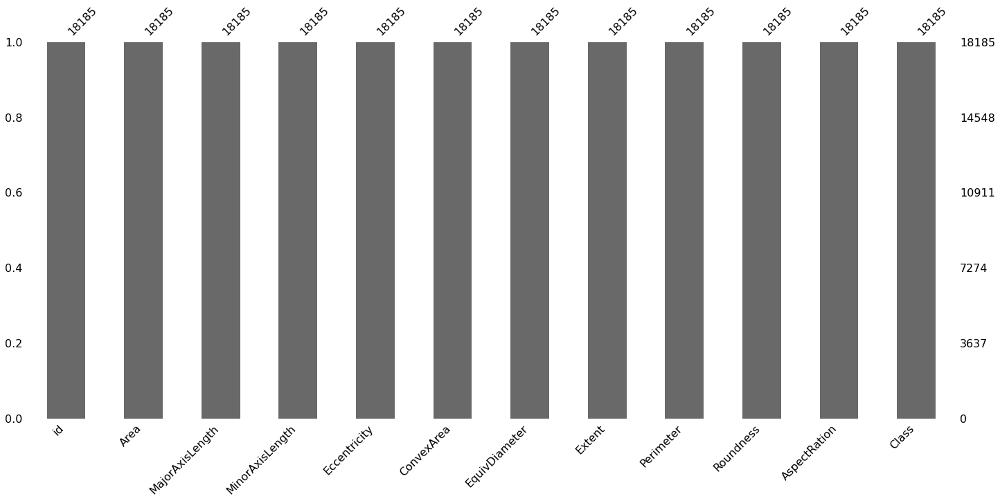

In [12]:
msno.bar(df)

Besides, there are no missing number or empty values in any feature present in the dataset.

## Checking whether dataset is balanced or not

In [13]:
print('There are total',df['Class'].nunique(),'unique values in the outcome column')
print('Unique values in outcome column are',df['Class'].unique())

There are total 2 unique values in the outcome column
Unique values in outcome column are [1 0]


In [14]:
print('Total number of 0(False count) are',(df['Class']==0).sum())
print('Total number of 1(True count) are',(df['Class']==1).sum())

Total number of 0(False count) are 8200
Total number of 1(True count) are 9985


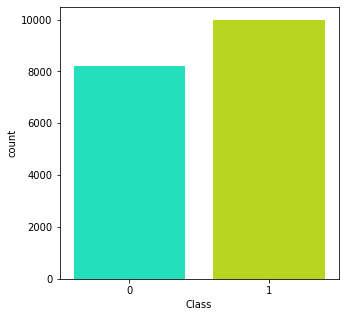

In [15]:
plt.figure(figsize=(5,5))
colors = ['#04FFCD','#CCF500']
sns.countplot(x='Class',data=df,palette=colors)
plt.show()

From the above figure, it is very clear that the output classes are pretty well balanced and there is no need of sampling.

## Building Correlation Matrix and Data Cleaning(Removing Outliers)
Feature selection process is the vital part in the whole life cycle.

It is clear from the dataframe that there is no need of Id column and hence our first step would be to remove that unnecessary column from the dataframe.:

### Building Correlation Matrix

In [16]:
df.drop(columns=['id'],inplace=True)
df

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
0,4537,92.229316,64.012769,0.719916,4677,76.004525,0.657536,273.085,0.764510,1.440796,1
1,2872,74.691881,51.400454,0.725553,3015,60.471018,0.713009,208.317,0.831658,1.453137,1
2,3048,76.293164,52.043491,0.731211,3132,62.296341,0.759153,210.012,0.868434,1.465950,1
3,3073,77.033628,51.928487,0.738639,3157,62.551300,0.783529,210.657,0.870203,1.483456,1
4,3693,85.124785,56.374021,0.749282,3802,68.571668,0.769375,230.332,0.874743,1.510000,1
...,...,...,...,...,...,...,...,...,...,...,...
18180,5853,148.624571,51.029281,0.939210,6008,86.326537,0.498594,332.960,0.663444,2.912535,0
18181,7585,169.593996,58.141659,0.939398,7806,98.272692,0.647461,385.506,0.641362,2.916910,0
18182,6365,154.777085,52.908085,0.939760,6531,90.023162,0.561287,342.253,0.682832,2.925396,0
18183,5960,151.397924,51.474600,0.940427,6189,87.112041,0.492399,343.371,0.635227,2.941216,0


In [17]:
df.corr()

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
Area,1.000000,0.599939,0.930215,-0.550073,0.999362,0.998158,0.230541,0.881540,0.620490,-0.623979,-0.816589
MajorAxisLength,0.599939,1.000000,0.273211,0.295717,0.602061,0.618002,-0.073549,0.870178,-0.202566,0.240471,-0.147741
MinorAxisLength,0.930215,0.273211,1.000000,-0.808640,0.928992,0.923790,0.308541,0.674249,0.834398,-0.860516,-0.917766
Eccentricity,-0.550073,0.295717,-0.808640,1.000000,-0.547896,-0.534688,-0.329954,-0.165915,-0.903657,0.950301,0.788636
ConvexArea,0.999362,0.602061,0.928992,-0.547896,1.000000,0.997403,0.227359,0.886987,0.610236,-0.621472,-0.814214
EquivDiameter,0.998158,0.618002,0.923790,-0.534688,0.997403,1.000000,0.225944,0.891567,0.607432,-0.609957,-0.809361
Extent,0.230541,-0.073549,0.308541,-0.329954,0.227359,0.225944,1.000000,0.073227,0.366793,-0.350875,-0.303440
Perimeter,0.881540,0.870178,0.674249,-0.165915,0.886987,0.891567,0.073227,1.000000,0.186063,-0.227256,-0.533274
Roundness,0.620490,-0.202566,0.834398,-0.903657,0.610236,0.607432,0.366793,0.186063,1.000000,-0.947875,-0.831759
AspectRation,-0.623979,0.240471,-0.860516,0.950301,-0.621472,-0.609957,-0.350875,-0.227256,-0.947875,1.000000,0.832563


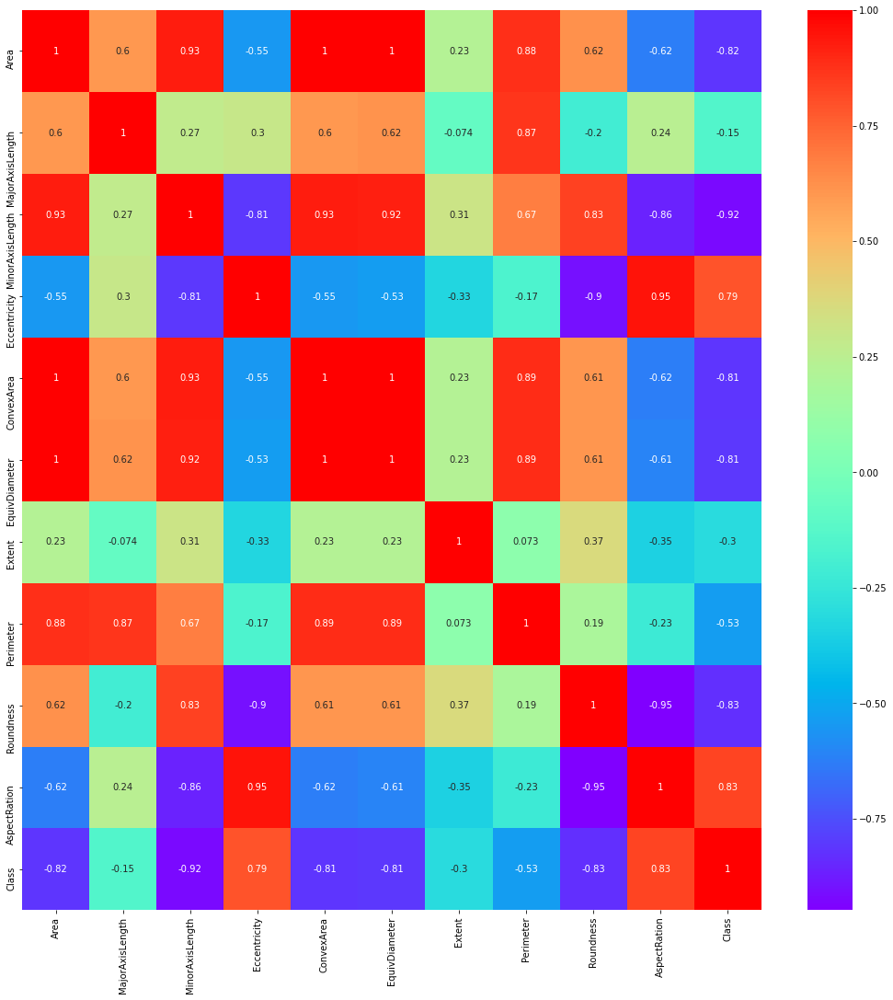

In [18]:
correlation_mat = df.corr()
corr_features = correlation_mat.index
plt.figure(figsize=(18,18))
g = sns.heatmap(df[corr_features].corr(),annot=True,cmap='rainbow')
plt.show()

## Data Cleaning(Removing Outliers)
Outliers badly affect mean and standard deviation of the dataset. These may statistically give erroneous results.

Most machine learning algorithms do not work well in the presence of outlier. So it is desirable to detect and remove outliers.

Inter Quartile Range approach to finding the outliers is the most commonly used and most trusted approach used in the research field.

In [19]:
df

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
0,4537,92.229316,64.012769,0.719916,4677,76.004525,0.657536,273.085,0.764510,1.440796,1
1,2872,74.691881,51.400454,0.725553,3015,60.471018,0.713009,208.317,0.831658,1.453137,1
2,3048,76.293164,52.043491,0.731211,3132,62.296341,0.759153,210.012,0.868434,1.465950,1
3,3073,77.033628,51.928487,0.738639,3157,62.551300,0.783529,210.657,0.870203,1.483456,1
4,3693,85.124785,56.374021,0.749282,3802,68.571668,0.769375,230.332,0.874743,1.510000,1
...,...,...,...,...,...,...,...,...,...,...,...
18180,5853,148.624571,51.029281,0.939210,6008,86.326537,0.498594,332.960,0.663444,2.912535,0
18181,7585,169.593996,58.141659,0.939398,7806,98.272692,0.647461,385.506,0.641362,2.916910,0
18182,6365,154.777085,52.908085,0.939760,6531,90.023162,0.561287,342.253,0.682832,2.925396,0
18183,5960,151.397924,51.474600,0.940427,6189,87.112041,0.492399,343.371,0.635227,2.941216,0


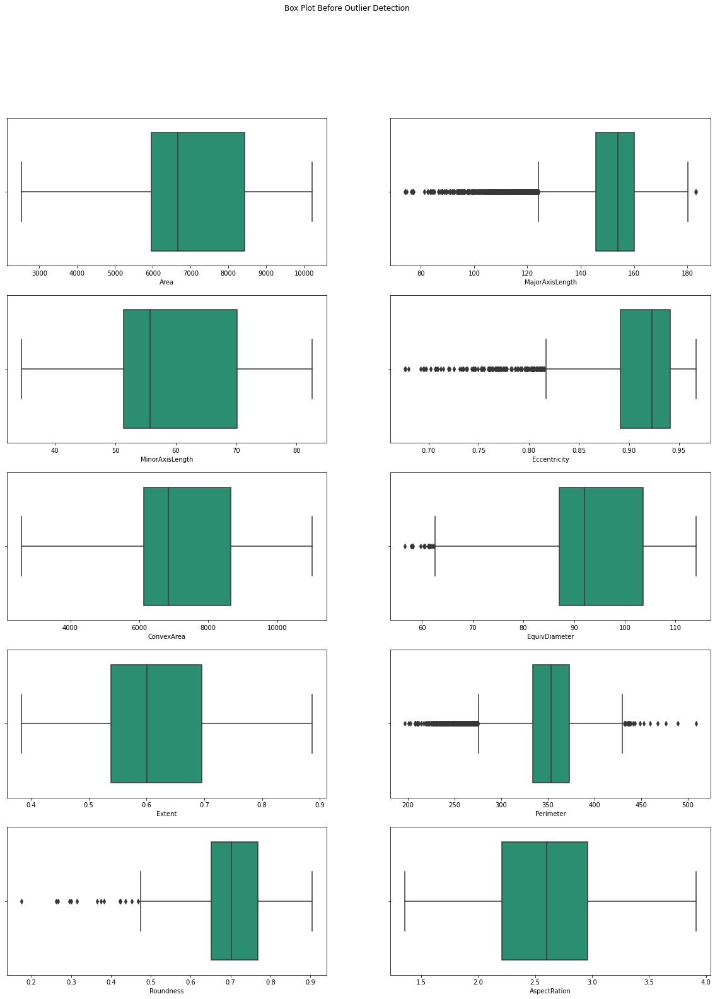

In [20]:
fig, axes = plt.subplots(5,2, figsize=(20,25))
fig.suptitle('Box Plot Before Outlier Detection')
k = 0
for i in range(0,5):
    for j in range(0,2):
        sns.boxplot(ax=axes[i,j], data=df, x=df.columns[k], palette='Dark2')
        k=k+1

In [21]:
# Calculating the IQR
def iqr_calculation(main_df,col):
    Q1 = np.percentile(col,25,interpolation = 'midpoint')
    Q3 = np.percentile(col,75,interpolation = 'midpoint')
    IQR = Q3 - Q1
    upper = np.where(col>=(Q3+1.5*IQR))
    lower = np.where(col<=(Q1-1.5*IQR))
    return upper,lower
    
# Remove the outliers
def remove_outliers(main_df,upper,lower):
    main_df.drop(upper[0], inplace = True)
    main_df.drop(lower[0], inplace = True)
    print("New Shape: ", main_df.shape)
    return main_df

# Resetting the dataframe index
def reset_dataframe(main_df):
    main_df.reset_index(inplace=True)
    main_df.drop(columns=['index'],inplace=True)
    return main_df

In [22]:
main_df = df

for i in range(0,len(main_df.columns)-1):
    print('For ',df.columns[i])
    upper, lower = iqr_calculation(main_df,df[df.columns[i]])
    main_df = remove_outliers(main_df,upper,lower)
    final_df = reset_dataframe(main_df)

For  Area
New Shape:  (18185, 11)
For  MajorAxisLength
New Shape:  (17647, 11)
For  MinorAxisLength
New Shape:  (17647, 11)
For  Eccentricity
New Shape:  (17631, 11)
For  ConvexArea
New Shape:  (17631, 11)
For  EquivDiameter
New Shape:  (17631, 11)
For  Extent
New Shape:  (17631, 11)
For  Perimeter
New Shape:  (17602, 11)
For  Roundness
New Shape:  (17597, 11)
For  AspectRation
New Shape:  (17597, 11)


In [23]:
final_df

,Area,MajorAxisLength,MinorAxisLength,Eccentricity,ConvexArea,EquivDiameter,Extent,Perimeter,Roundness,AspectRation,Class
0,6374,129.576759,63.762307,0.870549,6476,90.086785,0.662234,314.656,0.809003,2.032184,1
1,6946,136.303603,65.738475,0.876009,7115,94.042128,0.594437,338.782,0.760508,2.073422,1
2,5786,125.555431,59.626250,0.880040,5945,85.831020,0.623491,307.304,0.769931,2.105707,1
3,5896,127.013995,59.843292,0.882050,6092,86.643063,0.610352,309.264,0.774655,2.122443,1
4,6082,129.098407,60.416315,0.883736,6204,87.999107,0.661375,308.106,0.805111,2.136814,1
...,...,...,...,...,...,...,...,...,...,...,...
17592,5853,148.624571,51.029281,0.939210,6008,86.326537,0.498594,332.960,0.663444,2.912535,0
17593,7585,169.593996,58.141659,0.939398,7806,98.272692,0.647461,385.506,0.641362,2.916910,0
17594,6365,154.777085,52.908085,0.939760,6531,90.023162,0.561287,342.253,0.682832,2.925396,0
17595,5960,151.397924,51.474600,0.940427,6189,87.112041,0.492399,343.371,0.635227,2.941216,0


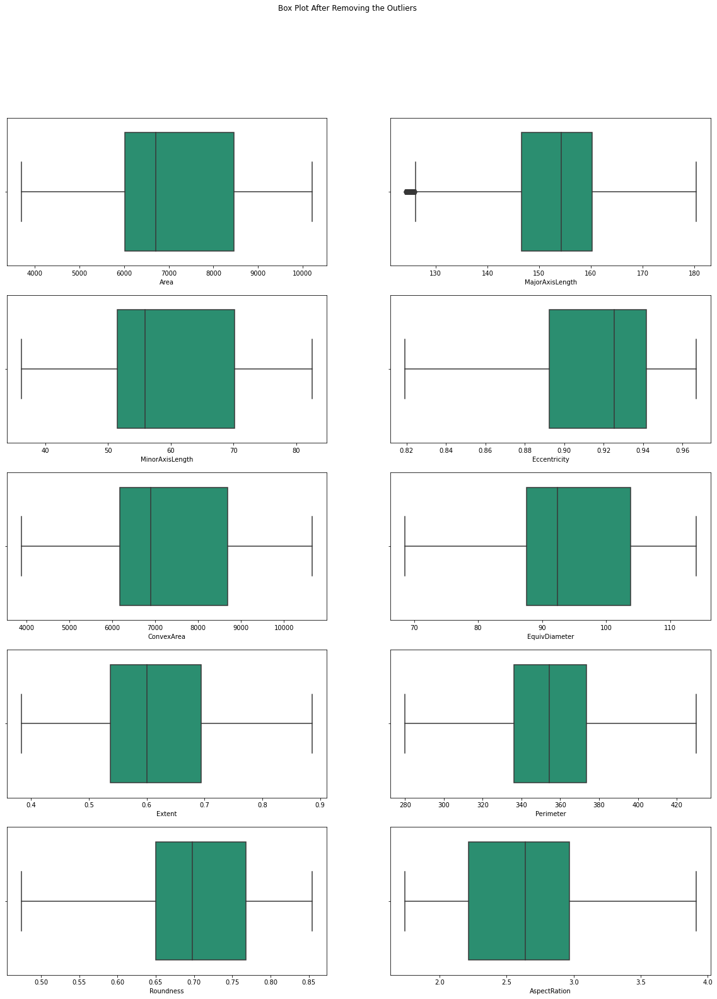

In [24]:
fig, axes = plt.subplots(5,2, figsize=(20,25))
fig.suptitle('Box Plot After Removing the Outliers')
k = 0
for i in range(0,5):
    for j in range(0,2):
        col_name = final_df.columns[k]
        sns.boxplot(ax=axes[i,j], data=final_df,x=col_name,palette='Dark2')
        k=k+1

## Data Visualization 

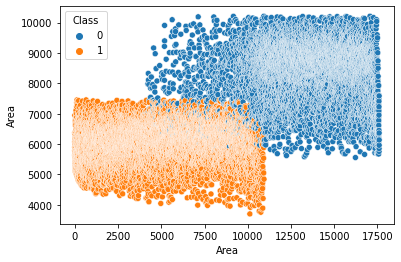

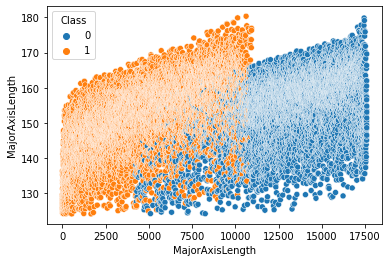

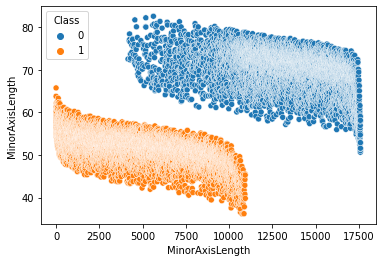

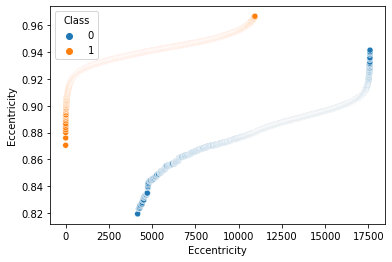

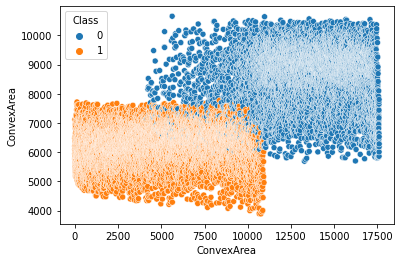

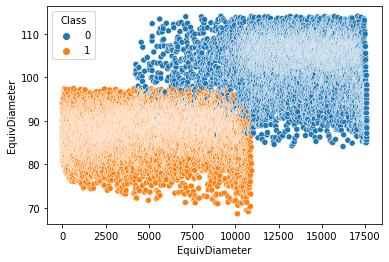

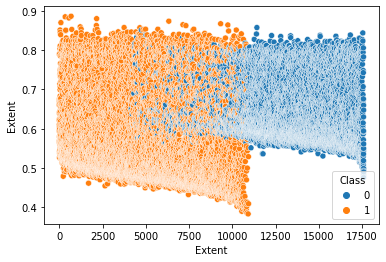

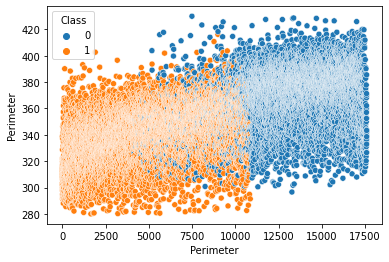

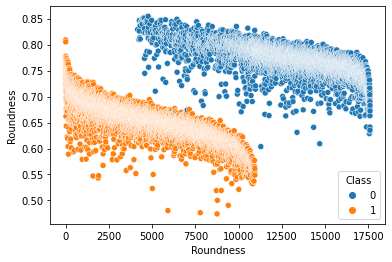

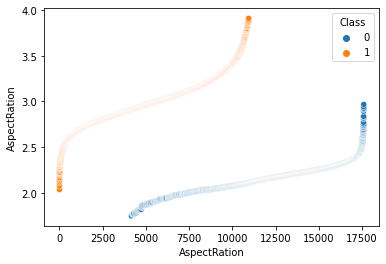

In [25]:
## Visualize data variables with data class
features = ['Area','MajorAxisLength','MinorAxisLength','Eccentricity','ConvexArea',
            'EquivDiameter','Extent','Perimeter','Roundness','AspectRation']
for graph in features:
    sns.scatterplot(data = final_df,x=np.arange(0,df[graph].shape[0]),y=df[graph],hue=df['Class'])
    plt.xlabel(graph)
    plt.show()

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



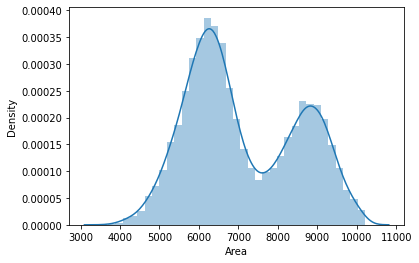

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



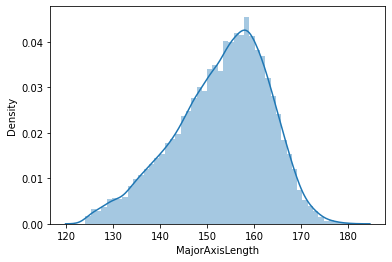

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



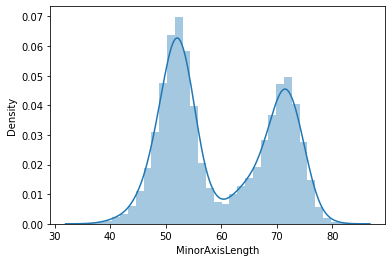

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



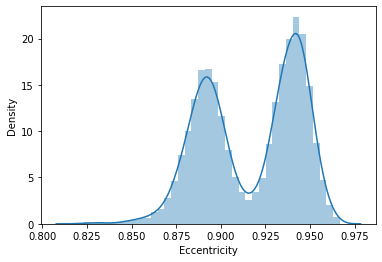

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



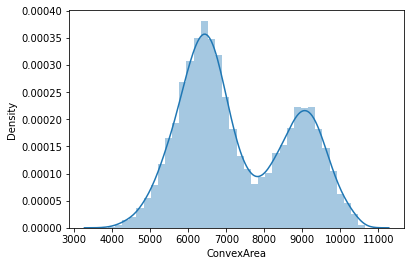

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



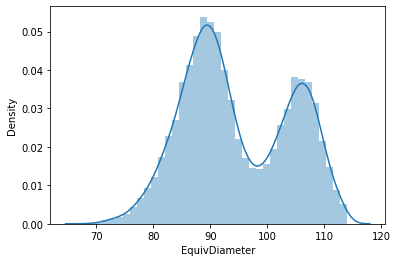

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



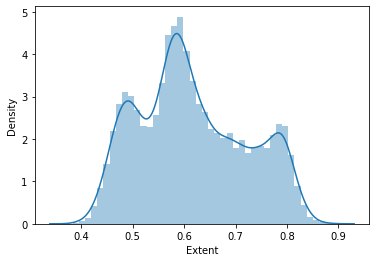

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



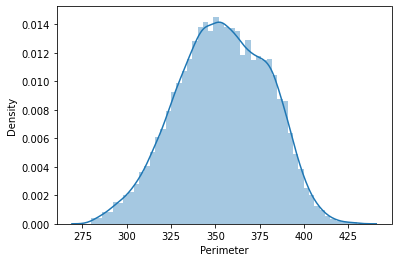

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



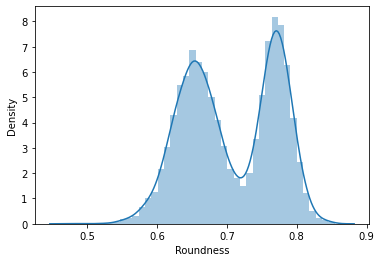

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



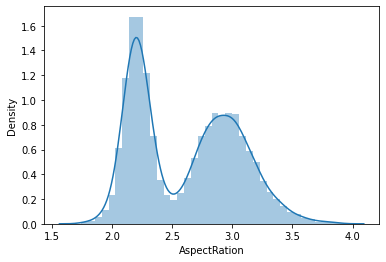

In [26]:
## Show description of variables
for hist in features:
    sns.distplot(df[hist])
    plt.xlabel(hist)
    plt.show()

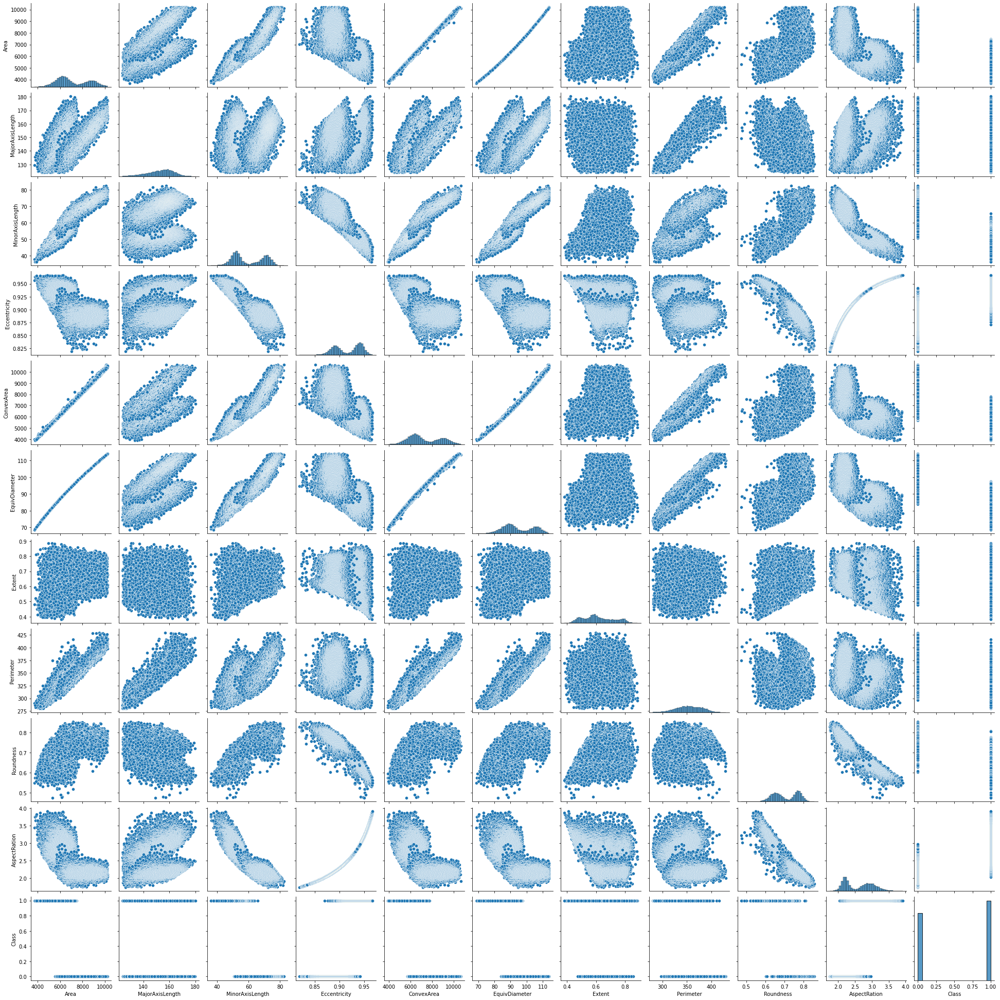

In [27]:
sns.pairplot(final_df)

In [28]:
lst = [i for i in final_df.columns]
fig = make_subplots(rows=5, cols=2,subplot_titles=(lst))

k=0
for i in range(1,6):
    for j in range(1,3):
        col_name = final_df.columns[k]
        fig.append_trace(go.Histogram(x=final_df[final_df.columns[k]],name=final_df.columns[k]), row=i, col=j)
        fig.update_layout(
                            template='plotly_dark',
                            height=1500, 
                            width=1200,
                            title_text="Histogram of all the input features",
                            font_family="Times New Roman"
                        )
        k=k+1

fig.show()

In [29]:
lst = [i for i in final_df.columns]
fig = make_subplots(rows=5, cols=2,subplot_titles=(lst))

k=0
for i in range(1,6):
    for j in range(1,3):
        col_name = final_df.columns[k]
        fig.append_trace(go.Violin(y=final_df[final_df.columns[k]],name=final_df.columns[k],box_visible=True), row=i, col=j)
        fig.update_layout(
                            template='plotly_dark',
                            height=2000, 
                            width=1200,
                            title_text="Violin Plot of all the input features",
                            font_family="Times New Roman"
                        )
        k=k+1

fig.show()

## Applying Standardization and Splitting the training data
Now, we will standardize the whole data. Data standardization is the process of rescaling the attributes so that they have mean as 0 and variance as 1.

The ultimate goal to perform standardization is to bring down all the features to a common scale without distorting the differences in the range of the values.

In sklearn.preprocessing.StandardScaler(), centering and scaling happens independently on each feature.

The formula which performs standardization is (x−mean)/(sd)

fit_transform() is used on the training data so that we can scale the training data and also learn the scaling parameters of that data.

In [30]:
y = final_df['Class']
X = final_df.drop(columns=['Class'])
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)

In [31]:
from sklearn.feature_selection import SelectFromModel
from sklearn.ensemble import RandomForestClassifier as rf
import warnings
warnings.filterwarnings("ignore")
import eli5
from eli5.sklearn import PermutationImportance
perm = PermutationImportance(rf(n_estimators=100, random_state=0).fit(X,y),random_state=1).fit(X,y)
eli5.show_weights(perm, feature_names = X.columns.tolist())

Weight,Feature
0.0143 ± 0.0012,Roundness
0.0067 ± 0.0006,MinorAxisLength
0.0024 ± 0.0004,AspectRation
0.0020 ± 0.0003,Eccentricity
0.0017 ± 0.0002,ConvexArea
0.0016 ± 0.0003,Area
0.0015 ± 0.0003,Extent
0.0014 ± 0.0003,MajorAxisLength
0.0012 ± 0.0002,EquivDiameter
0.0010 ± 0.0003,Perimeter


In [32]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_train_scaled

array([[-0.7085519 , -0.22947603, -0.73742939, ..., -0.43844144,
        -0.79852573,  0.59201328],
       [ 1.06330706,  0.37240698,  1.11181697, ...,  0.94864149,
         0.76111001, -0.97183266],
       [-1.11956104,  0.59292898, -1.53021312, ..., -0.49685187,
        -1.66834014,  2.22485329],
       ...,
       [-0.15771492,  1.08939692, -0.50527081, ...,  0.3993044 ,
        -0.82063083,  0.86632641],
       [-0.3130792 , -0.10765373, -0.26678111, ...,  0.27457663,
        -0.9658156 ,  0.08529922],
       [ 0.8585087 ,  0.40863635,  0.86915486, ...,  0.66992259,
         0.80903888, -0.7755498 ]])

In [33]:
X_test_scaled = scaler.transform(X_test)
X_test_scaled

array([[-1.02069286, -1.17932721, -0.77358667, ..., -1.24014103,
        -0.29294766,  0.21432256],
       [ 0.33803837,  1.35059936, -0.09388449, ...,  0.6693412 ,
        -0.21465292,  0.47844359],
       [ 1.98984312,  1.0511613 ,  1.85372642, ...,  1.76836421,
         1.14707079, -1.26192683],
       ...,
       [-0.09486301, -1.29257639,  0.44583007, ..., -0.52433229,
         0.76827926, -1.03687044],
       [ 0.45809258,  0.06774699,  0.52669537, ...,  0.32283209,
         0.56091168, -0.61391138],
       [-0.62380775,  0.5792953 , -0.93232649, ..., -0.18045882,
        -0.98653376,  1.22561043]])

From the graph, we know that all the variables are important and can not be excluded.

## Building and Training Models

### Model 1: Logistic Regression

In [34]:
from sklearn.linear_model import LogisticRegression as lr
lr_model = lr()
lr_model.fit(X_train_scaled,y_train)
y_predicted = lr_model.predict(X_test_scaled)
print("Accuracy of Logistic Regression Model is = {0: .3f}".format(metrics.accuracy_score(y_test,y_predicted)))

Accuracy of Logistic Regression Model is =  0.991


In [35]:
print("Total 0's in training data:",(y_train == 0).sum())
print("Total 1's in training data:",(y_train == 1).sum())
print("Total 0's in testing data:",(y_test == 0).sum())
print("Total 1's in testing data:",(y_test == 1).sum())

Total 0's in training data: 5646
Total 1's in training data: 6671
Total 0's in testing data: 2409
Total 1's in testing data: 2871


#### Logistic Regression Feature Importance

We can fit a Logistic Regression model on the given dataset and retrieve the coeff_ property that contains the coefficients found for each input variable.

These coefficients can provide the basis for a crude feature importance score. This assumes that the input variables have the same scale or have been scaled prior to fitting a model.

Results may vary given the stochastic nature of the algorithm or evaluation procedure, or differences in numerical precision.

We know that it is a classification problem with classes 0 and 1. Notice that the coefficients are both positive and negative. The positive scores indicate a feature that predicts class 1, whereas the negative scores indicate a feature that predicts class 0.

No clear pattern of important and unimportant features can be identified from these results.

In [36]:
importance = lr_model.coef_[0]

for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))

fig = px.bar(x=[x for x in range(len(importance))], y=importance)
fig.update_layout(template='plotly_dark',
                  height=700, 
                  width=1000,
                  title_text="Feature score using Logistic Regression",
                  xaxis_title="Total number of features",
                  yaxis_title="Importance of each feature",
                  font=dict(
                            family="Times New Roman, monospace",
                            size=14,
                            color="White"
                           )
                 )
fig.show()

Feature: 0, Score: -1.58481
Feature: 1, Score: 1.34790
Feature: 2, Score: -0.71455
Feature: 3, Score: 0.36992
Feature: 4, Score: -2.33022
Feature: 5, Score: -1.67799
Feature: 6, Score: 0.02020
Feature: 7, Score: -0.01523
Feature: 8, Score: -2.81346
Feature: 9, Score: 0.59681


#### Hyperparameter Tuning

Logistic regression does not really have any critical hyperparameters to tune. But sometimmes we can see useful differences in performance or convergence with different solvers.

Regularization(penalty) can be useful sometimes.

The C parameter which is there helps to control the penalty strength, which can also be effective.

In the below code snippet, I have used the GridSearchCV in order to tune the hyperparameters.

In [37]:
lr_model = lr()

solvers = ['newton-cg','lbfgs','liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]

grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search_lr = GridSearchCV(estimator=lr_model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_search_lr.fit(X_train_scaled, y_train)

print(grid_search_lr)
print("Best accuracy: %f using %s" % (grid_search_lr.best_score_, grid_search_lr.best_params_))

GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=10, random_state=1),
             error_score=0, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [100, 10, 1.0, 0.1, 0.01], 'penalty': ['l2'],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear']},
             scoring='accuracy')
Best accuracy: 0.989689 using {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}


In [38]:
y_score = grid_search_lr.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test, y_score)
fig_hist = px.histogram(x=y_score, color=y_test,nbins=50,labels=dict(color='True Labels', x='Score'))
fig_hist.show()

In [39]:
df = pd.DataFrame({
    'False Positive Rate': fpr,
    'True Positive Rate': tpr
}, index=thresholds)
df.index.name = "Thresholds"
df.columns.name = "Rate"

fig_thresh = px.line(
    df, title='TPR and FPR at every threshold',
)

fig_thresh.update_yaxes(scaleanchor="x", scaleratio=1)
fig_thresh.update_xaxes(range=[0, 1], constrain='domain')
fig_thresh.show()

In [40]:
y_score = grid_search_lr.predict_proba(X_test_scaled)[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, y_score)

fig = px.area(
    x=fpr, y=tpr,
    title=f'ROC Curve (AUC={auc(fpr, tpr):.4f})',
    labels=dict(x='False Positive Rate', y='True Positive Rate'),
)
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)

fig.update_yaxes(showgrid=False,scaleanchor="x", scaleratio=1)
fig.update_xaxes(showgrid=False,constrain='domain')
fig.show()

In [41]:
y_predicted = grid_search_lr.predict(X_test_scaled)
print("Accuracy of Logistic Regression Model after Hyper-Parameter Tuning is = {0: .3f}".format(metrics.accuracy_score(y_test,y_predicted)))
lr_score = metrics.accuracy_score(y_test,y_predicted)

Accuracy of Logistic Regression Model after Hyper-Parameter Tuning is =  0.992


In [42]:
y_actual = y_test
y_actual = y_actual.to_numpy() #  COnverting to numpy array
y_actual

array([1, 0, 0, ..., 0, 0, 1])

In [43]:
target_names = ['class 0', 'class 1']
print(classification_report(y_actual, y_predicted, target_names=target_names))

              precision    recall  f1-score   support

     class 0       1.00      0.99      0.99      2409
     class 1       0.99      1.00      0.99      2871

    accuracy                           0.99      5280
   macro avg       0.99      0.99      0.99      5280
weighted avg       0.99      0.99      0.99      5280



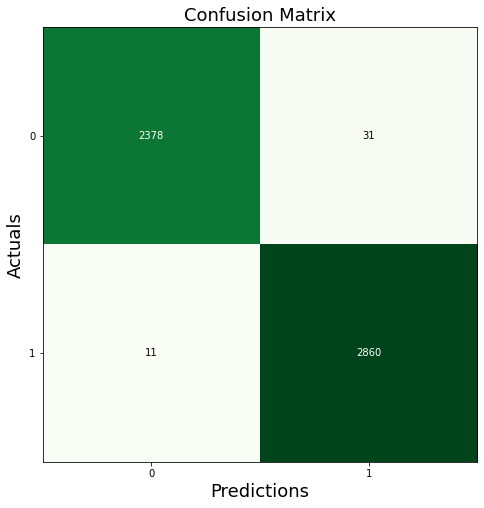

In [44]:
conf_matrix = confusion_matrix(y_true=y_actual, y_pred=y_predicted)
fig, ax = plot_confusion_matrix(conf_mat=conf_matrix, figsize=(8,8), cmap=plt.cm.Greens)
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

### Model 2: Decision Tree

In [45]:
from sklearn.tree import DecisionTreeClassifier
dtc_model = DecisionTreeClassifier()
dtc_model.fit(X_train_scaled,y_train)
y_predicted = dtc_model.predict(X_test_scaled)
print("Accuracy of Decision Tree Model is = {0: .3f}".format(metrics.accuracy_score(y_test,y_predicted)))

Accuracy of Decision Tree Model is =  0.986


#### Decision Tree Feature Importance

In [46]:
importance = dtc_model.feature_importances_

for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))

fig = px.bar(x=[x for x in range(len(importance))], y=importance)
fig.update_layout(template='plotly_dark',
                  height=700, 
                  width=1000,
                  title_text="Feature score using Decision Tree Classifier",
                  xaxis_title="Total number of features",
                  yaxis_title="Importance of each feature",
                  font=dict(
                            family="Times New Roman, monospace",
                            size=14,
                            color="White"
                           )
                 )
fig.show()

Feature: 0, Score: 0.00105
Feature: 1, Score: 0.00230
Feature: 2, Score: 0.95934
Feature: 3, Score: 0.00156
Feature: 4, Score: 0.00272
Feature: 5, Score: 0.00311
Feature: 6, Score: 0.00408
Feature: 7, Score: 0.00322
Feature: 8, Score: 0.02003
Feature: 9, Score: 0.00259


#### Hyperparameter Tuning

In [47]:
dtc_model = DecisionTreeClassifier()
params = {
    'max_depth': [2, 3, 5, 10, 20],
    'min_samples_leaf': [5, 10, 20, 50, 100],
    'criterion': ["gini", "entropy"]
}
#cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search_dtc = GridSearchCV(estimator=dtc_model, param_grid=params, cv=4, n_jobs=-1, verbose=1, scoring = "accuracy")
grid_search_dtc.fit(X_train_scaled, y_train)

print(grid_search_dtc)
print("Best accuracy: %f using %s" % (grid_search_dtc.best_score_, grid_search_dtc.best_params_))

Fitting 4 folds for each of 50 candidates, totalling 200 fits
GridSearchCV(cv=4, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100]},
             scoring='accuracy', verbose=1)
Best accuracy: 0.988877 using {'criterion': 'entropy', 'max_depth': 5, 'min_samples_leaf': 20}


In [48]:
score_df = pd.DataFrame(grid_search_dtc.cv_results_)
score_df.head(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.037330,0.000319,0.001537,0.000098,gini,2,5,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.985065,0.985060,0.984411,0.982787,0.984331,0.000930,39
1,0.037705,0.001277,0.001536,0.000105,gini,2,10,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.985065,0.985060,0.984411,0.982787,0.984331,0.000930,39
2,0.041082,0.004102,0.001518,0.000061,gini,2,20,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.985065,0.985060,0.984411,0.982787,0.984331,0.000930,39
3,0.044344,0.007582,0.001631,0.000106,gini,2,50,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.985065,0.985060,0.983436,0.982787,0.984087,0.001002,42
4,0.041219,0.003558,0.001680,0.000136,gini,2,100,"{'criterion': 'gini', 'max_depth': 2, 'min_sam...",0.985065,0.985060,0.983111,0.982787,0.984006,0.001063,43
5,0.064311,0.011375,0.001476,0.000034,gini,3,5,"{'criterion': 'gini', 'max_depth': 3, 'min_sam...",0.986039,0.990257,0.981812,0.986684,0.986198,0.002999,20
6,0.055952,0.005553,0.001504,0.000025,gini,3,10,"{'criterion': 'gini', 'max_depth': 3, 'min_sam...",0.986039,0.990257,0.982137,0.986684,0.986279,0.002881,19
7,0.052935,0.000863,0.001554,0.000033,gini,3,20,"{'criterion': 'gini', 'max_depth': 3, 'min_sam...",0.985714,0.989932,0.982137,0.986684,0.986117,0.002778,21
8,0.052274,0.000262,0.001591,0.000116,gini,3,50,"{'criterion': 'gini', 'max_depth': 3, 'min_sam...",0.987013,0.989607,0.982462,0.986359,0.986360,0.002558,15
9,0.052234,0.000685,0.001485,0.000035,gini,3,100,"{'criterion': 'gini', 'max_depth': 3, 'min_sam...",0.985065,0.985060,0.983111,0.982787,0.984006,0.001063,43


In [49]:
score_df.tail(10)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
40,0.125086,0.005205,0.001534,0.000009,entropy,10,5,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.985065,0.984086,0.983436,0.981812,0.983600,0.001184,49
41,0.122371,0.005068,0.001569,0.000012,entropy,10,10,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.987662,0.990257,0.986034,0.983436,0.986847,0.002479,9
42,0.119143,0.005836,0.001544,0.000030,entropy,10,20,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.988961,0.988308,0.987009,0.987334,0.987903,0.000776,4
43,0.113985,0.006254,0.001561,0.000015,entropy,10,50,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.986364,0.987658,0.986359,0.985060,0.986360,0.000919,12
44,0.102770,0.002716,0.001540,0.000023,entropy,10,100,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.985065,0.987658,0.984411,0.983761,0.985224,0.001479,28
45,0.125840,0.004120,0.001565,0.000013,entropy,20,5,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.984091,0.984411,0.982137,0.980838,0.982869,0.001460,50
46,0.123070,0.004735,0.001585,0.000021,entropy,20,10,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.987662,0.990257,0.986034,0.983436,0.986847,0.002479,9
47,0.114540,0.014700,0.001448,0.000184,entropy,20,20,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.988961,0.988308,0.987009,0.987334,0.987903,0.000776,4
48,0.107929,0.018401,0.001454,0.000208,entropy,20,50,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.986364,0.987658,0.986359,0.985060,0.986360,0.000919,12
49,0.089327,0.015869,0.001374,0.000216,entropy,20,100,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.985065,0.987658,0.984411,0.983761,0.985224,0.001479,28


In [50]:
y_score = grid_search_dtc.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test, y_score)
fig_hist = px.histogram(x=y_score, color=y_test,nbins=50,labels=dict(color='True Labels', x='Score'))
fig_hist.show()

In [51]:
df = pd.DataFrame({
    'False Positive Rate': fpr,
    'True Positive Rate': tpr
}, index=thresholds)
df.index.name = "Thresholds"
df.columns.name = "Rate"

fig_thresh = px.line(
    df, title='TPR and FPR at every threshold',
)

fig_thresh.update_yaxes(scaleanchor="x", scaleratio=1)
fig_thresh.update_xaxes(range=[0, 1], constrain='domain')
fig_thresh.show()

In [52]:
y_score = grid_search_dtc.predict_proba(X_test_scaled)[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, y_score)

fig = px.area(
    x=fpr, y=tpr,
    title=f'ROC Curve (AUC={auc(fpr, tpr):.4f})',
    labels=dict(x='False Positive Rate', y='True Positive Rate'),
)
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)

fig.update_yaxes(showgrid=False,scaleanchor="x", scaleratio=1)
fig.update_xaxes(showgrid=False,constrain='domain')
fig.show()

In [53]:
y_predicted = grid_search_dtc.predict(X_test_scaled)
print("Accuracy of Decision Tree Model after Hyper-Parameter Tuning is = {0: .3f}".format(metrics.accuracy_score(y_test,y_predicted)))
dtc_score = metrics.accuracy_score(y_test,y_predicted)

Accuracy of Decision Tree Model after Hyper-Parameter Tuning is =  0.990


In [54]:
y_actual = y_test
y_actual = y_actual.to_numpy() #  COnverting to numpy array
y_actual

array([1, 0, 0, ..., 0, 0, 1])

In [55]:
target_names = ['class 0', 'class 1']
print(classification_report(y_actual, y_predicted, target_names=target_names))

              precision    recall  f1-score   support

     class 0       0.99      0.98      0.99      2409
     class 1       0.99      0.99      0.99      2871

    accuracy                           0.99      5280
   macro avg       0.99      0.99      0.99      5280
weighted avg       0.99      0.99      0.99      5280



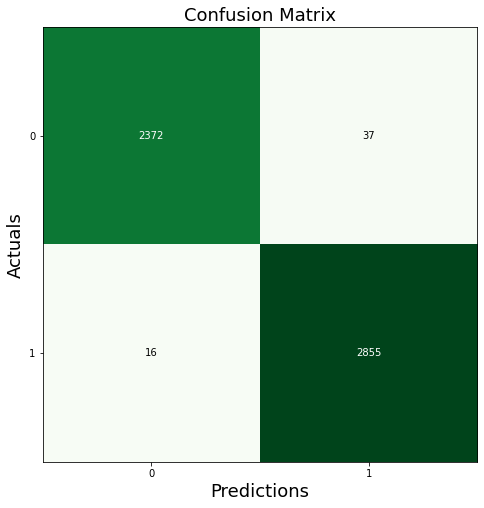

In [56]:
conf_matrix = confusion_matrix(y_true=y_actual, y_pred=y_predicted)
fig, ax = plot_confusion_matrix(conf_mat=conf_matrix, figsize=(8,8), cmap=plt.cm.Greens)
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

### Model 3: Random Forest

In [57]:
from sklearn.ensemble import RandomForestClassifier
rfc_model = RandomForestClassifier()
rfc_model.fit(X_train_scaled,y_train)
y_predicted = rfc_model.predict(X_test_scaled)
print("Accuracy of Random Forest Classifier Model is = {0: .3f}".format(metrics.accuracy_score(y_test,y_predicted)))

Accuracy of Random Forest Classifier Model is =  0.991


#### Random Forest Classifier Feature Importance

In [58]:
importance = rfc_model.feature_importances_

for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))

fig = px.bar(x=[x for x in range(len(importance))], y=importance)
fig.update_layout(template='plotly_dark',
                  height=700, 
                  width=1000,
                  title_text="Feature score using Random Forest Classifier",
                  xaxis_title="Total number of features",
                  yaxis_title="Importance of each feature",
                  font=dict(
                            family="Times New Roman, monospace",
                            size=14,
                            color="White"
                           )
                 )
fig.show()

Feature: 0, Score: 0.03122
Feature: 1, Score: 0.00439
Feature: 2, Score: 0.35205
Feature: 3, Score: 0.20718
Feature: 4, Score: 0.02521
Feature: 5, Score: 0.08407
Feature: 6, Score: 0.00391
Feature: 7, Score: 0.00924
Feature: 8, Score: 0.12931
Feature: 9, Score: 0.15342


#### Hyperparameter Tuning

In [59]:
rfc_model = RandomForestClassifier()
params = {
    'n_estimators' : [10, 100, 1000],
    'max_features' : ['sqrt', 'log2']
}
#cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search_rfc = GridSearchCV(estimator=rfc_model, param_grid=params, cv=4, n_jobs=-1, verbose=1, scoring = "accuracy")
grid_search_rfc.fit(X_train_scaled, y_train)

print(grid_search_rfc)
print("Best accuracy: %f using %s" % (grid_search_rfc.best_score_, grid_search_rfc.best_params_))

Fitting 4 folds for each of 6 candidates, totalling 24 fits
GridSearchCV(cv=4, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_features': ['sqrt', 'log2'],
                         'n_estimators': [10, 100, 1000]},
             scoring='accuracy', verbose=1)
Best accuracy: 0.988146 using {'max_features': 'log2', 'n_estimators': 1000}


In [60]:
score_df = pd.DataFrame(grid_search_rfc.cv_results_)
score_df

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_features,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.249512,0.012364,0.007176,0.000398,sqrt,10,"{'max_features': 'sqrt', 'n_estimators': 10}",0.986688,0.988308,0.983761,0.985060,0.985954,0.001709,6
1,2.539261,0.057873,0.059680,0.010064,sqrt,100,"{'max_features': 'sqrt', 'n_estimators': 100}",0.988636,0.990257,0.986359,0.986034,0.987822,0.001727,4
2,25.578592,0.295820,0.495840,0.007543,sqrt,1000,"{'max_features': 'sqrt', 'n_estimators': 1000}",0.988312,0.990581,0.986359,0.985710,0.987740,0.001899,5
3,0.253808,0.010254,0.007158,0.000251,log2,10,"{'max_features': 'log2', 'n_estimators': 10}",0.989286,0.989607,0.987334,0.986034,0.988065,0.001460,2
4,2.497906,0.048007,0.051248,0.001667,log2,100,"{'max_features': 'log2', 'n_estimators': 100}",0.987338,0.991880,0.986359,0.985710,0.987822,0.002414,3
5,25.444184,0.330346,0.487994,0.114816,log2,1000,"{'max_features': 'log2', 'n_estimators': 1000}",0.988636,0.990581,0.986684,0.986684,0.988146,0.001616,1


In [61]:
y_score = grid_search_rfc.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test, y_score)
fig_hist = px.histogram(x=y_score, color=y_test,nbins=50,labels=dict(color='True Labels', x='Score'))
fig_hist.show()

In [62]:
df = pd.DataFrame({
    'False Positive Rate': fpr,
    'True Positive Rate': tpr
}, index=thresholds)
df.index.name = "Thresholds"
df.columns.name = "Rate"

fig_thresh = px.line(
    df, title='TPR and FPR at every threshold',
)

fig_thresh.update_yaxes(scaleanchor="x", scaleratio=1)
fig_thresh.update_xaxes(range=[0, 1], constrain='domain')
fig_thresh.show()

In [63]:
y_score = grid_search_rfc.predict_proba(X_test_scaled)[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, y_score)

fig = px.area(
    x=fpr, y=tpr,
    title=f'ROC Curve (AUC={auc(fpr, tpr):.4f})',
    labels=dict(x='False Positive Rate', y='True Positive Rate'),
)
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)

fig.update_yaxes(showgrid=False,scaleanchor="x", scaleratio=1)
fig.update_xaxes(showgrid=False,constrain='domain')
fig.show()

In [64]:
y_predicted = grid_search_rfc.predict(X_test_scaled)
print("Accuracy of Decision Tree Model after Hyper-Parameter Tuning is = {0: .3f}".format(metrics.accuracy_score(y_test,y_predicted)))
rfc_score = metrics.accuracy_score(y_test,y_predicted)

Accuracy of Decision Tree Model after Hyper-Parameter Tuning is =  0.991


In [65]:
y_actual = y_test
y_actual = y_actual.to_numpy() #  COnverting to numpy array
y_actual

array([1, 0, 0, ..., 0, 0, 1])

In [66]:
target_names = ['class 0', 'class 1']
print(classification_report(y_actual, y_predicted, target_names=target_names))

              precision    recall  f1-score   support

     class 0       0.99      0.99      0.99      2409
     class 1       0.99      1.00      0.99      2871

    accuracy                           0.99      5280
   macro avg       0.99      0.99      0.99      5280
weighted avg       0.99      0.99      0.99      5280



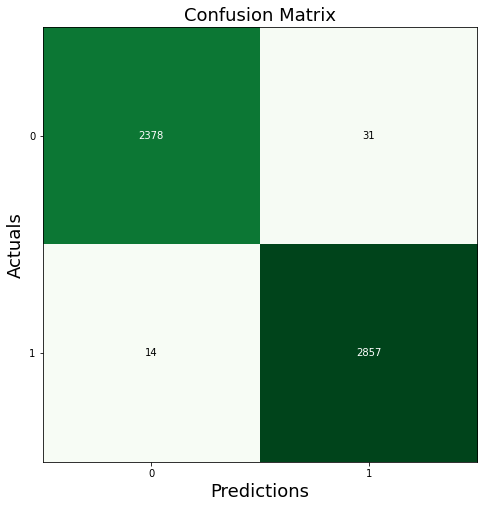

In [67]:
conf_matrix = confusion_matrix(y_true=y_actual, y_pred=y_predicted)
fig, ax = plot_confusion_matrix(conf_mat=conf_matrix, figsize=(8,8), cmap=plt.cm.Greens)
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

## Model Comparasion

In [68]:
models = pd.DataFrame({
    'Model' : [ 'Logistic Regression', 'Decision Tree Classifier', 'Random Forest Classifier'],
    'Score' : [ lr_score, dtc_score, rfc_score]
})
models.sort_values(by = 'Score', ascending = False)

,Model,Score
0,Logistic Regression,0.992045
2,Random Forest Classifier,0.991477
1,Decision Tree Classifier,0.989962


## Answer the following questions
1. Is the relationship significant?
    - Yes. It is for all the three multivariate models we build for making the rice classification. This can be done via showing the p-value.
2. Are any model assumptions violated?
    - No. There are implicit independent variables in the model and all the variables are independent variables. Besides, we have removed the outliers and applied standardization before predicting the model.
3. Is there any multicollinearity in the model?
    - No. We have checked the Variance Inflation Factor(VIF) and it's below the expected range.
4. In the multivariate models are predictor variables independent of all the other predictor variables?
    - Yes. Predictor variables independent of all the other predictor variables from the graph.
5. In in multivariate models rank the most significant predictor variables and exclude insignificant ones from the model.
    - Here are the variables randked from the most significant to the less significant: Roundness, MinorAxisLength, AspectRation, Eccentricity, ConvexArea, Area, Extent, MajorAxisLength, EquivDiameter, Perimeter.
6. Does the model make sense?
    - Yes. From the model results, they all make sense and work very well. Logistic Regression got 0.992045. Random Forest Classifier got 0.991856. Decision Tree Classifier got 0.989962.
7. Does regularization help?
    - Regularization does help sometimes in our prediction models. And the C parameter which is there helps to control the penalty strength, which can also be effective. Therefore, I have used the GridSearchCV in order to tune the hyperparameters.
8. Which independent variables are significant?
    - For all the three models, all the 10 independent variables are significant. There we kept all 10 variables to make the 3 prediction models. The variables are Roundness, MinorAxisLength, AspectRation, Eccentricity, ConvexArea, Area, Extent, MajorAxisLength, EquivDiameter, Perimeter.
9. Which hyperparameters are important?
    - For all the 3 models, C parameter which is there helps to control the penalty strength. Solver and penalty are important hyperparameters. 
10. Coding professionalism?
    - All the coding parts have followed professional rules.

## Refernces
1. Sckit learn offcial documentation
2. The Elements of Statistical Learning: Data Mining, Inference, and Prediction, Robert Tibshirani. Jerome Friedman
3. Python Machine Learning, First Edition, Sebastian Raschka.
The algorithms were referred directly from the Sckit learn official documentation. Exploratory Data Analysis and visualization was referred from the Machine Learning with scikit-learn Quick Start Guide and Towards Data Science. The remaining code was written independently. Feature importance reference is taken from eli5 offical documnetation. Machine learning models are referred from the book: The Elements of Statistical Learning: Data Mining, Inference, and Prediction.

The MIT License (MIT)
=====================

Copyright © `<2022>` `<Chao Yan>`

Permission is hereby granted, free of charge, to any person
obtaining a copy of this software and associated documentation
files (the “Software”), to deal in the Software without
restriction, including without limitation the rights to use,
copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the
Software is furnished to do so, subject to the following
conditions:

The above copyright notice and this permission notice shall be
included in all copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED “AS IS”, WITHOUT WARRANTY OF ANY KIND,
EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES
OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND
NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT
HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY,
WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING
FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR
OTHER DEALINGS IN THE SOFTWARE.
